# Güneş Sistemi Dinamiği Simülasyonu

Bu proje, **Python ve Matplotlib** kullanılarak hazırlanmış 3D bir Güneş Sistemi animasyon simülasyonudur.  
Animasyonda gezegenler gerçek boyut ve yörünge oranlarına yakın olarak modellenmiştir.

---

## Özellikler

- Güneş ve sekiz gezegen (Merkür → Neptün) simülasyonu  
- Her gezegenin kendi yörüngesinde dairesel hareketi  
- Gezegen boyutları güneşe göre orantılı olarak gösteriliyor  
- Animasyon süresince geçerli tarih ve saat **sol üst köşede** gösteriliyor  
- 3D yörüngeler ile hafif derinlik efekti  
- Güneş merkezde sabit, parlak ve büyük olarak gösteriliyor

---

## Kullanılan Kütüphaneler

- `numpy` → Matematiksel hesaplamalar  
- `matplotlib` → 3D grafikler ve animasyon  
- `mpl_toolkits.mplot3d` → 3D eksenler  
- `datetime` → Animasyonda geçen zamanı hesaplamak için  

---

## Nasıl Çalışır?

1. Gezegenlerin ortalama yörünge yarıçapları ve yörünge periyotları tanımlanır.  
2. Dairesel yörüngeler için açı `angle = 2π * frame * Δt / period` formülü ile hesaplanır.  
3. Her frame için gezegenlerin x, y, z koordinatları güncellenir.  
4. Gezegenlerin hareketi `FuncAnimation` ile animasyona dönüştürülür.  
5. Sol üst köşede animasyon zamanı güncellenir.

---

## Örnek Kullanım (Jupyter Notebook)

```python
from IPython.display import HTML
HTML(anim.to_jshtml())


Animation size has reached 21007018 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


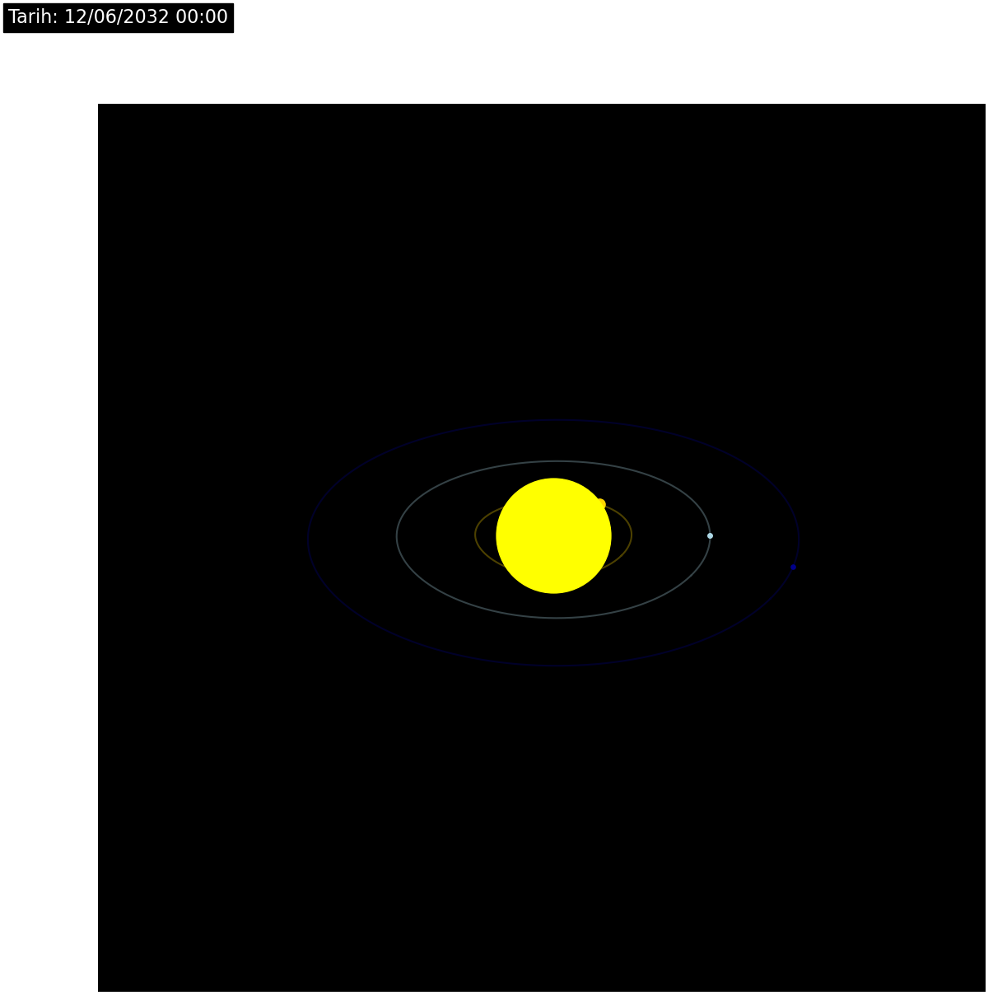

In [4]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from mpl_toolkits.mplot3d import Axes3D
import datetime

# -------------------------
# Güneş Sistemi Parametreleri
# -------------------------
planets = ["Merkür","Venüs","Dünya","Mars","Jüpiter","Satürn","Uranüs","Neptün"]
colors = ["gray","orange","blue","red","brown","gold","lightblue","darkblue"]

# Ortalama yörünge yarıçapları (AU)
radii = np.array([0.39,0.72,1.0,1.52,5.2,9.58,19.2,30.05])

# Yörünge periyotları (gün)
periods = np.array([88,225,365,687,4333,10759,30687,60190])

# Gerçekçi boyutlar (Güneş = 1, AU = astronomik birimler)
# Görsellik için ölçeklendirme
sun_size = 5.0
planet_sizes = np.array([0.0035,0.0087,0.0092,0.0049,0.102,0.095,0.040,0.038])*sun_size*200  # boyutlar büyütüldü

# Zaman ayarları
time_step = 5  # gün/frame
num_frames = 500
start_date = datetime.datetime(2025, 8, 13, 0, 0, 0)

# -------------------------
# Figür ve 3D Eksen
# -------------------------
fig = plt.figure(figsize=(14,14))
ax = fig.add_subplot(111, projection='3d')
ax.set_facecolor('black')
ax.grid(False)
ax.axis('off')
ax.set_xlim([-35,35])
ax.set_ylim([-35,35])
ax.set_zlim([-10,10])

# Güneş
ax.scatter(0,0,0,color='yellow',s=sun_size*2000,zorder=10,label="Güneş")

# Gezegen noktaları
planet_dots = [ax.plot([],[],[], 'o', color=colors[i], markersize=planet_sizes[i]/10)[0] for i in range(len(planets))]

# Yörüngeler
theta = np.linspace(0, 2*np.pi, 500)
for i in range(len(planets)):
    x = radii[i]*np.cos(theta)
    y = radii[i]*np.sin(theta)
    z = 0.1*np.sin(2*theta)
    ax.plot(x,y,z,color=colors[i],alpha=0.3)

# Zaman text (sol üst)
time_text = fig.text(0.05, 0.95, '', color='white', fontsize=16, backgroundcolor='black')

# -------------------------
# Animasyon Fonksiyonu
# -------------------------
def update(frame):
    current_date = start_date + datetime.timedelta(days=frame*time_step)
    time_text.set_text(f"Tarih: {current_date.strftime('%d/%m/%Y %H:%M')}")
    for i in range(len(planets)):
        angle = 2*np.pi*frame*time_step/periods[i]
        x = radii[i]*np.cos(angle)
        y = radii[i]*np.sin(angle)
        z = 0.1*np.sin(2*angle)
        planet_dots[i].set_data([x],[y])
        planet_dots[i].set_3d_properties([z])
    return planet_dots + [time_text]

# -------------------------
# Animasyon Oluşturma
# -------------------------
anim = FuncAnimation(fig, update, frames=num_frames, interval=50, blit=False)

# -------------------------
# Jupyter Notebooks için Görselleştirme
# -------------------------
from IPython.display import HTML
HTML(anim.to_jshtml())
